In [1]:
import os
import random
from datetime import time
import pandas as pd
import numpy as np
# import modin.pandas as md
import pysam
import math
import pickle
import plotly.graph_objects as go
import plotly.express as px
from scipy.optimize import curve_fit, minimize, Bounds, newton
from scipy import special
import matplotlib.pyplot as plt
from multiprocessing import Pool
from functools import partial
import seaborn as sns
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error
from sklearn import preprocessing
from scipy.stats import pearsonr, spearmanr
import tqdm


/usr/lib/python3/dist-packages/sklearn/externals/joblib.py:1: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  import imp


In [2]:
! ls -l ../../carmelab/backup/genomes/
# ! pip3 install pysam

total 8882249
-rw-r--r-- 1 tomerozen lirancarmel_lab   18205278 May  1 16:12 Altai_ch21.csv
-rw-r--r-- 1 tomerozen lirancarmel_lab 1565364111 May  5 16:57 altai_chr21_correct.csv
-rw-r--r-- 1 tomerozen lirancarmel_lab 1834520936 May 22 12:22 altai_chr21_correct_df20_thresh.csv
-rw-r--r-- 1 tomerozen lirancarmel_lab 1951591804 May  8 17:11 altai_chr21_correct_df3.csv
-rw-r--r-- 1 tomerozen lirancarmel_lab    9152970 May 13 20:39 altai_chr21_df3_meth_parallel.csv
-rw-r--r-- 1 tomerozen lirancarmel_lab   12587179 May 14 17:34 altai_chr21_df3_meth_smooth.csv
-rw-r--r-- 1 tomerozen lirancarmel_lab   12245093 May 15 02:27 altai_chr21_df3_meth_smooth_window_19.csv
-rw-r--r-- 1 tomerozen lirancarmel_lab 1664446430 May 22 15:08 altai_chr21_match_roam.csv
-rw-r--r-- 1 tomerozen lirancarmel_lab 1618960882 May 22 20:00 altai_chr21_match_roam_no_thresh.csv
-rw-r--r-- 1 tomerozen lirancarmel_lab    8299883 May  6 20:03 altai_chr21_meth_parallel.csv
-rw-r--r-- 1 tomerozen lirancarmel_lab   12144152 M

## Open, read and parse BAM file and CpG coordinates file:

In [3]:
def load_samfile(sample_name):
    sample_name = sample_name.lower()
    if sample_name == "altai":
        samfile_path = "../../carmelab/backup/genomes/from_Arielle/altai/altai_bams/Altai_chr21.bam"
#         samfile_path = "altai_chr21.bam"
    elif sample_name == "vindija_udg":
        samfile_path = "../../carmelab/backup/genomes/vindija/UDG_chr21.bam"
    elif sample_name == "vindija_non_udg":
        samfile_path = "../../carmelab/backup/genomes/vindija/unsorted_nonUDG_merged_chr21.bam"
    else:
        raise ValueError(f'Unknown sample name: {sample_name}')
    
    samfile = pysam.AlignmentFile(samfile_path, "rb")
    return samfile

In [4]:
def meth_couple_merge(val_1, val_2):
    # return average of two values, if both are not nan. If one is nan, return the other. If both are nan, return nan
    if np.isnan(val_1):
        return val_2
    elif np.isnan(val_2):
        return val_1
    else:
        return (val_1 + val_2) / 2

# test meth_couple_merge

assert meth_couple_merge(1, 1) == 1
assert meth_couple_merge(1, 0) == 0.5
assert meth_couple_merge(0, 1) == 0.5
assert meth_couple_merge(0, 0) == 0
assert meth_couple_merge(np.nan, 1) == 1
assert meth_couple_merge(1, np.nan) == 1
assert meth_couple_merge(np.nan, np.nan) is np.nan

In [5]:
def read_met_values(chr, cpg_coords):
    with open(f"../../carmelab/backup/genomes/bone5/lined_chr{chr}.txt") as met_file:
#     with open(f"bone5/lined_chr{chr}.txt") as met_file:
        # read all the lines in the file into a list, and remove the newline character. for every value in the CpG coordinates list, get the value from the list of lines, using the meth_couple_merge function, and add the Cpg to a dictionary, with the value as the methylation value
        meth_vals = met_file.read().splitlines()
        meth_vals.remove(meth_vals[0])
        meth_dict = {}
        print("Total number of positions:",len(meth_vals))
        for i, cpg in enumerate(cpg_coords):
            if i % 100000 == 0:
                print("cpg coordinates read: ", i)
            meth_dict[cpg] = meth_couple_merge(float(meth_vals[2*i]), float(meth_vals[(2*i)+1]))
            if i <= 10:
                print ("position:", cpg, "methylation values:", meth_vals[2*i], meth_vals[(2*i)+1], "merged:", meth_dict[cpg])

    return meth_dict


In [6]:
with open ("../../carmelab/backup/genomes/cpg_coords_chr21.txt") as cpg_coords_file:
# with open ("./cpg_coords_chr21.txt") as cpg_coords_file:
    cpg_coords = cpg_coords_file.read().splitlines()

# handle first one, has a \t in it
cpg_coords[0] = cpg_coords[0].replace("\t", ",").split(",")[1]
chr21_cpgs_dict = read_met_values(21, cpg_coords)


Total number of positions: 760888
cpg coordinates read:  0
position: 9411552 methylation values: 5.600000e-01 4.700000e-01 merged: 0.515
position: 9411784 methylation values: 6.000000e-01 7.000000e-01 merged: 0.6499999999999999
position: 9412099 methylation values: 1 5.000000e-01 merged: 0.75
position: 9412376 methylation values: NaN 5.000000e-01 merged: 0.5
position: 9412503 methylation values: NaN 0 merged: 0.0
position: 9412808 methylation values: 0 0 merged: 0.0
position: 9413583 methylation values: 0 0 merged: 0.0
position: 9413763 methylation values: 1.500000e-01 4.000000e-02 merged: 0.095
position: 9414795 methylation values: 5.700000e-01 6.700000e-01 merged: 0.62
position: 9414804 methylation values: 4.700000e-01 6.700000e-01 merged: 0.5700000000000001
position: 9414920 methylation values: 7.900000e-01 1 merged: 0.895
cpg coordinates read:  100000
cpg coordinates read:  200000
cpg coordinates read:  300000


In [7]:
print(len(chr21_cpgs_dict.keys()))
# chr21_cpgs_dict

380444


## CpG islands

In [8]:
cpg_df = pd.read_csv("../../carmelab/backup/genomes/CpGs_Islands.csv", index_col=0)
# print(cpg_df.head())
# cpg_df.seqnames.unique()
# print(cpg_df.strand.unique())

In [ ]:
cpg_df.head()

In [ ]:
def get_distance_from_cpg(position, chromosome=21):
    print(position)
    distance_from_cpg = math.inf
    cpg_in_chrom = cpg_df.loc[cpg_df['seqnames'] == chromosome]
    #finding nearest CpG island, that starts before position in genome (because after is too late)
    nearest_earlier_island_start_index = np.searchsorted(cpg_in_chrom.start, position , side="right")[0] - 1
    print(nearest_earlier_island_start_index)
    nearest_earlier_island = cpg_in_chrom.iloc[nearest_earlier_island_start_index]
    # if it's end is after the position given, then it's within the island
    if position <= nearest_earlier_island.end:
        distance_from_cpg = 0
    else:
        distance_from_earlier = position - nearest_earlier_island.end
        distance_from_later = math.inf
        if (nearest_earlier_island_start_index + 1) < len(cpg_in_chrom):
            nearest_later_island = cpg_in_chrom.iloc[nearest_earlier_island_start_index + 1]
            distance_from_later = nearest_later_island.start - position
        distance_from_cpg = min(distance_from_earlier, distance_from_later)
                              
    return distance_from_cpg
    
    

# Generate DF of c sites

In [ ]:
# ones = 0
# for read in samfile.fetch('21'):
#     if (ones < 1) and (read.is_reverse):
#         if read.mapping_quality < 20 and read.query_length == read.reference_length:
#             read_aligned_pares = read.get_aligned_pairs()
#             read_sequence = read.query_sequence
#             ref_sequence = read.get_reference_sequence()
#             print(read_aligned_pares)
#             for index, base in enumerate(read_sequence):
#                 print(base, ref_sequence[index], index, read.query_length - (read_aligned_pares[index][0] + 1))
#         ones += 1

In [ ]:
# count = 0
# nones = 0
# for read in samfile.fetch(chromosome):
#     if read.mapping_quality < 20 and read.query_length == read.reference_length:
#         read_aligned_pares = read.get_aligned_pairs(matches_only=True)
#         read_sequence = read.query_sequence
#         ref_sequence = read.get_reference_sequence()
#         for index, base in enumerate(read_sequence):
#             print(read_aligned_pares[index])
#             if index == read_aligned_pares[index][0] and read.query_alignment_qualities[index] < 53 and read_aligned_pares[index][1] != None and(str(read_aligned_pares[index][1]+1) in chr21_cpgs_dict):
#                 if read_aligned_pares[index][1] is None:
#                     nones+=1
#                 count += 1
                
# print(nones)
# print(count)

In [ ]:
altai_chr21_samfile = load_samfile("altai")
# count amount of reads covering certain position / iterating over all positions in CpG dict
i = 0
cpg_coords = list(chr21_cpgs_dict.keys())
print("number of cpgs:", len(cpg_coords))
while i < 10:
    position = int(cpg_coords[i]) -1
    print("position", position, "count:\n", altai_chr21_samfile.count_coverage('21', position, position+1, quality_threshold=20))
    i += 1




In [ ]:
def generate_work_df(sample_name, start=None, stop=None):
    print(f"Processing {start} to {stop}\n")
    df_ls = []
    samfile = load_samfile(sample_name)
#     for chromosome in chromosomes_list:
#     print(f"Starting chromosome {chromosome}:")
    reads_processed = 0
    good_reads = 0
    fetched = samfile.fetch("21", start, stop)
    for read in fetched:
#         if read.mapping_quality > 20 and read.query_length == read.reference_length and not read.is_duplicate:# and read.is_forward:
#             good_reads += 1
#             read_aligned_pares = read.get_aligned_pairs()
#             read_sequence = read.query_sequence
#             ref_sequence = read.get_reference_sequence()
#             for index, base in enumerate(read_sequence):
#                 if  read_aligned_pares[index][1] and (str(read_aligned_pares[index][1]+1) in chr21_cpgs_dict) and index == read_aligned_pares[index][0] and read.query_alignment_qualities[index] > 20:
#                     position_in_reference = read_aligned_pares[index][1]
#                     letter_before_read = read_sequence[index-1] if index > 0 else "!"
#                     letter_after_read = read_sequence[index+1] if index+1 < len(read_sequence) else "!"
#                     #TODO - Should capitalize? 
#                     letter_before_ref = ref_sequence[index-1] if index > 0 else "!"
#                     letter_after_ref = ref_sequence[index+1] if index+1 < len(read_sequence) else "!"
#                     new_row = pd.DataFrame([{
#                         "read_name":read.query_name,
#                         "position_in_reference": position_in_reference,
#                         "position_in_read": read_aligned_pares[index][0],
#                         "after": base,
#                         "distance_from_end": read.query_length - (read_aligned_pares[index][0] + 1),
#                         "read_length": read.query_length,
# #                             "distance_from_cpg_island": get_distance_from_cpg(chromosome, position_in_reference),
#                         "letter_before_read": letter_before_read,
#                         "letter_after_read": letter_after_read,
#                         "letter_before_ref": letter_before_ref,
#                         "letter_after_ref": letter_after_ref,
#                         "is_cpg_coord": str(position_in_reference+1) in chr21_cpgs_dict,
#                         "is_reverse": read.is_reverse,
#                         "chromosome": 21,
#                         "modern_methylation": chr21_cpgs_dict[str(read_aligned_pares[index][1]+1)]
#                     }])
#                     df_ls.append(new_row)
            if read.mapping_quality > 18 and read.query_length == read.reference_length and not read.is_duplicate and not read.is_unmapped:# and read.is_forward:
                good_reads += 1
                read_aligned_pares = read.get_aligned_pairs()
                read_sequence = read.query_sequence
                ref_sequence = read.get_reference_sequence()
                for index, base in enumerate(read_sequence):
                    if read.is_forward:
                        if read_aligned_pares[index][1] and (str(read_aligned_pares[index][1]+1) in chr21_cpgs_dict) and index == read_aligned_pares[index][0] and read.query_alignment_qualities[index] > 20:
                            position_in_reference = read_aligned_pares[index][1]
                            new_row = pd.DataFrame([{
                                "read_name":read.query_name,
                                "position_in_reference": position_in_reference,
                                "position_in_read": read_aligned_pares[index][0],
                                "after": base,
                                "before": ref_sequence[index],
                                "distance_from_end": read.query_length - (read_aligned_pares[index][0] + 1),
                                "read_length": read.query_length,
        #                             "distance_from_cpg_island": get_distance_from_cpg(chromosome, position_in_reference),
#                                     "letter_before_read": letter_before_read,
#                                     "letter_after_read": letter_after_read,
#                                     "letter_before_ref": letter_before_ref,
#                                     "letter_after_ref": letter_after_ref,
#                                     "is_cpg_coord": str(position_in_reference+1) in chr21_cpgs_dict,
                                "is_reverse": read.is_reverse,
#                                     "chromosome": 21,
    #                             "modern_methylation": chr21_cpgs_dict[str(read_aligned_pares[index][1]+1)]
                            }])
                            df_ls.append(new_row)
                            
                    else:
                        if read_aligned_pares[index][1] and (str(read_aligned_pares[index][1]) in chr21_cpgs_dict) and index == read_aligned_pares[index][0] and read.query_alignment_qualities[index] > 20:
                            position_in_reference = read_aligned_pares[index][1] - 1
                            new_row = pd.DataFrame([{
                                "read_name":read.query_name,
                                "position_in_reference": position_in_reference,
                                "position_in_read": read_aligned_pares[index][0],
                                "after": "T" if base.lower() == "a" else "C",
                                "before": ref_sequence[index],
                                "distance_from_end": read.query_length - (read_aligned_pares[index][0] + 1),
                                "read_length": read.query_length,
        #                             "distance_from_cpg_island": get_distance_from_cpg(chromosome, position_in_reference),
#                                     "letter_before_read": letter_before_read,
#                                     "letter_after_read": letter_after_read,
#                                     "letter_before_ref": letter_before_ref,
#                                     "letter_after_ref": letter_after_ref,
#                                     "is_cpg_coord": str(position_in_reference+1) in chr21_cpgs_dict,
                                "is_reverse": read.is_reverse,
#                                     "chromosome": 21,
    #                             "modern_methylation": chr21_cpgs_dict[str(read_aligned_pares[index][1]+1)]
                            }])
                            df_ls.append(new_row)
#     print(f"Finished processing {reads_processed} reads,  {good_reads} were good")
    samfile.close()
    if df_ls:
        return pd.concat(df_ls, axis=0, ignore_index=True)
    else:
        return pd.DataFrame(columns = ["read_name",
                        "position_in_reference",
                        "position_in_read",
                        "after",
                        "distance_from_end",
                        "read_length",
#                             "distance_from_cpg_island": get_distance_from_cpg(chromosome, position_in_reference),
                        "letter_before_read",
                        "letter_after_read",
                        "letter_before_ref",
                        "letter_after_ref",
                        "is_cpg_coord",
                        "is_reverse",
                        "chromosome",
                        "modern_methylation"])

In [ ]:
def generate_work_df_parallel(sample_name, start=None, stop=None, n_workers=4, chunk_size=100000):
    chunk_starts = list(range(start, stop, chunk_size))
#     print(chunk_starts)
    chunk_stops = chunk_starts[1:] + [stop]
#     print(chunk_stops)
    chunks = [(sample_name, chunk_start, chunk_stop) for chunk_start, chunk_stop in zip(chunk_starts, chunk_stops)]
#     print(chunks)
    with Pool(processes=n_workers) as pool:
        results = pool.starmap(generate_work_df, chunks)
    
#     print(results)
    return pd.concat(results, axis=0, ignore_index=True)



In [ ]:
%%time
df_20_thresh = generate_work_df_parallel("altai", start=9411551, stop=48119537, n_workers=32, chunk_size=100000)
df_20_thresh["distance_from_nearest_end"] = df_20_thresh[["position_in_read", "distance_from_end"]].min(axis=1)


In [ ]:
%%time
df_20_thresh.to_csv('../../carmelab/backup/genomes/altai_chr21_match_roam.csv')

In [ ]:
df = df_20_thresh

In [73]:
df = pd.read_csv('../../carmelab/backup/genomes/altai_chr21_match_roam.csv')
df.head()

,Unnamed: 0,after,before,chromosome,distance_from_end,is_cpg_coord,is_reverse,letter_after_read,letter_after_ref,letter_before_read,letter_before_ref,modern_methylation,position_in_read,position_in_reference,read_length,read_name,distance_from_nearest_end
0,0,C,C,NaN,27,NaN,False,NaN,NaN,NaN,NaN,NaN,134,9411551,162,SN928_0068_BB022WACXX:6:2306:9440:29193,27.0
1,1,C,G,NaN,6,NaN,True,NaN,NaN,NaN,NaN,NaN,126,9411551,133,NIOBE_0139_A_D0B5GACXX:7:1201:14343:159519,6.0
2,2,C,G,NaN,25,NaN,True,NaN,NaN,NaN,NaN,NaN,124,9411551,150,NIOBE_0139_A_D0B5GACXX:6:1306:13633:113108,25.0
3,3,C,G,NaN,51,NaN,True,NaN,NaN,NaN,NaN,NaN,115,9411551,167,SN928_0068_BB022WACXX:1:2104:16265:114404,51.0
4,4,C,G,NaN,13,NaN,True,NaN,NaN,NaN,NaN,NaN,106,9411551,120,SN928_0068_BB022WACXX:4:1107:3959:100604,13.0


In [ ]:
samfile = load_samfile("altai")
for read in samfile.fetch("21", 9411551, 9411552):
    if read.query_name.startswith("SN928_0073_BD0J78ACXX:1:1103:16254:61515"):
        print(read.query_sequence)
        print(read.is_reverse)
        print(read.get_aligned_pairs())
        print(read.get_forward_qualities())
        print(read.mapping_quality)


samfile.close()
    

In [ ]:
samfile = load_samfile("altai")
for read in samfile.fetch("21", 9413762, 9413763):
    if read.query_name.startswith("SN928_0073_BD0J78ACXX:1:1103:16254:61515"):
        print("\n\nForward Read!\n\n")
        print(read.query_sequence)
        print(read.is_reverse)
        print(read.get_aligned_pairs())
    if read.query_name.startswith("SN928_0068_BB022WACXX:4:1306:15921:4773"):
        print("\n\nbackward Read!\n\n")
        print(read.query_sequence)
        print(read.is_reverse)
        print(read.get_aligned_pairs())

    

In [ ]:
df["distance_from_nearest_end"] = df[["position_in_read", "distance_from_end"]].min(axis=1)

In [ ]:
df.to_csv('../../carmelab/backup/genomes/altai_chr21_correct.csv')

In [ ]:
altai_df = pd.read_csv('../../carmelab/backup/genomes/altai_chr21_correct.csv', index_col=0)
altai_df["distance_from_nearest_end"] = altai_df[["position_in_read", "distance_from_end"]].min(axis=1)

In [ ]:
df = pd.read_csv('../../carmelab/backup/genomes/altai_chr21_correct_df3.csv', index_col=0)


In [ ]:
df.after.value_counts(normalize=True) * 100

In [ ]:
df.read_length.describe()

In [74]:
df['position_in_read'] = df['position_in_read'] - 1
df = df[df["position_in_read"] >= 0]

In [75]:
df['distance_from_end'] = df['distance_from_end'] - 1
df = df[df["distance_from_end"] >= 0]

In [76]:
df["distance_from_nearest_end"] = df[["position_in_read", "distance_from_end"]].min(axis=1)

# Creating Sum Table

In [77]:
def create_sum_table(df, col, bases_list=["C", "T", "A", "G"]):
    df_ct = df[df["after"].isin(bases_list)]
    final = df_ct.groupby('after')[col].value_counts().unstack().fillna(0)
    final_sum = final.sum(numeric_only=True)
    final_div = final.div(final_sum, axis = 1).T
    return final_div

#     df_ct = df[df["after"].isin(bases_list)]
#     df_for = df_ct[df_ct["is_reverse"] == False]
#     df_back = df_ct[df_ct["is_reverse"] == True]
#     final_for = df_for.groupby('after')[col].value_counts().unstack().fillna(0)
#     final_back = df_back.groupby('after')[col].value_counts().unstack().fillna(0)
#     final_sum_for = final_for.sum(numeric_only=True)
#     final_sum_back = final_back.sum(numeric_only=True)
#     final_div_for = final_for.div(final_sum_for, axis = 1).T
#     final_div_back = final_back.div(final_sum_back, axis = 1).T
#     final_div_back.index += 1
#     final = (final_div_back + final_div_for) /2
#     return final.iloc[1:]

# final_cut.iloc[:, :-1] = df.iloc[:, :-1].div(final_sum, axis=1)
# after_rate_A = final_cut.iloc[0] / final_sum * 100
# after_rate_C = final_cut.iloc[1] / final_sum * 100
# after_rate_G = final_cut.iloc[2] / final_sum * 100
# after_rate_T = final_cut.iloc[3] / final_sum * 100

In [ ]:
df[df["is_reverse"] == False].head()

In [78]:
sum_table = create_sum_table(df, col="distance_from_nearest_end")
# sum_table.head()
fig = px.line(sum_table.iloc[:75, :], y=["C", "T", "A", "G"], title="Fraction of C -> all bases change, as a factor of distance from read 5' end")
fig.show()

In [ ]:
sum_table.loc[:30, 'T']

# Comparing Different Genomes

## Vindija UDG vs. Non-UDG

In [ ]:
udg_df = pd.read_csv("../../carmelab/backup/genomes/vindija/chr21_df.csv")
non_udg_df = pd.read_csv("../../carmelab/backup/genomes/vindija/chr21_non_udg_df.csv")

In [ ]:
udg_df["distance_from_nearest_end"] = udg_df[["position_in_read", "distance_from_end"]].min(axis=1)
non_udg_df["distance_from_nearest_end"] = non_udg_df[["position_in_read", "distance_from_end"]].min(axis=1)

In [ ]:
udg_sum = create_sum_table(udg_df, "distance_from_end", ["C", "T"])
non_udg_sum = create_sum_table(non_udg_df, "distance_from_end", ["C", "T"])
udg_comp_df = pd.concat([udg_sum, non_udg_sum], axis=0, ignore_index=True)
udg_comp_df.rename(index={0: "C_UDG",1: 'T_UDG', 2: 'C_Non_UDG', 3: 'T_Non_UDG'}, inplace=True)
udg_comp_df.T.head(10)

In [ ]:
fig = px.line(udg_comp_df.T.iloc[:10, :], y=["C_UDG", "T_UDG", "C_Non_UDG", "T_Non_UDG"], title="Comparing C -> T ratio, between UDG and Non-UDG Vindija, distance from read 3' end")
fig.show()

# Modeling Exponential Decay

In [79]:
def exp_decay(x, a, b, c):
    return (a * np.exp(-b * x)) + c

In [ ]:
# split df to train and test, calculate sum table for train, fit model, calculate sum table for test, calculate error
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error

df_train = df.sample(frac=0.8, random_state=42)
df_test = df.drop(df_train.index)

mse_ls = []
for length in range(3, 31):
    local_mse = []
    kf = KFold(n_splits=5, shuffle=True, random_state=42)
    for train_index, test_index in kf.split(df_train):
        sum_table_train = create_sum_table(df.iloc[train_index, :], col="distance_from_nearest_end")
        sum_table_test = create_sum_table(df.iloc[test_index, :], col="distance_from_nearest_end")
        params, param_cov = curve_fit(exp_decay, np.arange(length+1), sum_table_train.loc[:length, 'T'])
        exp_x = np.arange(31)
        exp_y = exp_decay(exp_x, params[0], params[1], params[2])
        mse = mean_squared_error(sum_table_test.loc[:30, 'T'], exp_y)
        # print(f"Length: {length}, MSE: {mse}")
        local_mse.append(mse)
    print(f"Length: {length}, Avg MSE: {np.mean(local_mse)}")
    mse_ls.append(np.mean(local_mse))



In [ ]:
def calc_mse(train_length, train_df):
    local_mse = []
    kf = KFold(n_splits=5, shuffle=True, random_state=42)
    for train_index, test_index in kf.split(train_df):
        sum_table_train = create_sum_table(df.iloc[train_index, :], col="distance_from_nearest_end")
        sum_table_test = create_sum_table(df.iloc[test_index, :], col="distance_from_nearest_end")
        params, param_cov = curve_fit(exp_decay, np.arange(train_length+1), sum_table_train.loc[:train_length, 'T'])
        exp_x = np.arange(31)
        exp_y = exp_decay(exp_x, params[0], params[1], params[2])
        mse = mean_squared_error(sum_table_test.loc[:30, 'T'], exp_y)
        # print(f"Length: {length}, MSE: {mse}")
        local_mse.append(mse)
    print(f"Length: {train_length}, Avg MSE: {np.mean(local_mse)}")
    return np.mean(local_mse)


In [ ]:
%%time
df_train = df.sample(frac=0.8, random_state=42)
df_test = df.drop(df_train.index)

lengths = [(length, df_train) for length in range(3, 31)]
with Pool(processes=32) as pool:
    mse_ls = pool.starmap(calc_mse, lengths)
    
best_length = np.argmin(mse_ls) + 3
print(f"Best Length: {best_length}, Best MSE: {mse_ls[best_length-3]}")
# test curve fit accuracy over test df
sum_table_train = create_sum_table(df_train, col="distance_from_nearest_end")
sum_table_test = create_sum_table(df_test, col="distance_from_nearest_end")
params, param_cov = curve_fit(exp_decay, np.arange(best_length+1), sum_table_train.loc[:best_length, 'T'])
exp_x = np.arange(31)
exp_y = exp_decay(exp_x, params[0], params[1], params[2])
mse = mean_squared_error(sum_table_test.loc[:30, 'T'], exp_y)
print(f"Best Length: {best_length}, MSE: {mse}")

In [ ]:
# plot mse as a function of length
fig = px.line(x=np.arange(3, 31), y=mse_ls, title="MSE as a function of length")
fig.show()
# plot best fit curve


In [ ]:
# test curve fit accuracy over test df
exp_x = np.arange(31)
exp_y = exp_decay(exp_x, params[0], params[1], params[2])
print(len(exp_y))
fig = px.line(sum_table_test.loc[:31, :], y=["C", "T"], title="Fraction of C -> all bases change, as a factor of distance from read 5' end")
fig1 = px.line(x=exp_x, y=exp_y, title="Exponent modeling of ")
# fig1.show()
fig.add_trace(fig1.data[0])
fig.show()


In [80]:
best_length = 10
params, param_cov = curve_fit(exp_decay, np.arange(best_length+1), sum_table.loc[:best_length, "T"])

In [ ]:
best_length

In [ ]:
exp_x = np.arange(31)
exp_y = exp_decay(exp_x, params[0], params[1], params[2])
print(len(exp_y))
fig = px.line(sum_table.loc[:31, :], y=["C", "T"], title="Fraction of C -> all bases change, as a factor of distance from read 5' end")
fig1 = px.line(x=exp_x, y=exp_y, title="Exponent modeling of ")
# fig1.show()
fig.add_trace(fig1.data[0])
fig.show()


# Finding Numerical Solution for the MLE

## Utils and Infrastructure

In [ ]:
df.head()

In [ ]:
# altai_df = pd.read_csv('../../carmelab/backup/genomes/from_Arielle/altai/altai_bams/Altai_chr21_from_copy.csv', index_col=0)
# altai_df = pd.read_csv('Altai_chr21_from_copy.csv', index_col=0)
altai_df = df
altai_df["distance_from_nearest_end"] = altai_df[["position_in_read", "distance_from_end"]].min(axis=1)
df = altai_df
df.head()

# Estimating Pi SS degradation rate

In [81]:
df["modern_methylation"] = df["position_in_reference"].apply(lambda x: chr21_cpgs_dict[str(x + 1)])

In [ ]:
len(df[df["modern_methylation"] >= 1]) 

In [82]:
# find the rows in df that are in the cpgs dict and have a 0 distance from end and methylation value in the dict is larger than 0
# df[df["position_in_reference"].isin(chr21_cpgs_dict.keys()) & (df["distance_from_nearest_end"] == 0) & (df["methylation"] > 0)]
# df
df_zero_positions = df[df["distance_from_nearest_end"] == 0]
#
# df_zero_positions["methylation"] = df_zero_positions["position_in_read"].apply(lambda x: chr21_cpgs_dict[str(x + 1)])
methylated_at_ends = df_zero_positions[df_zero_positions["modern_methylation"] >=1]
# count number of T in the after column and divide by total number of reads
pi_ss = methylated_at_ends["after"].value_counts()["T"] / methylated_at_ends["after"].value_counts().sum()
print("Single Strand Deamination Rate: ", pi_ss)

# meth_zero_positions = df_zero_positions.replace({"methylation": chr21_cpgs_dict})
# meth_zero_positions
# meth_zero_positions[meth_zero_positions["position_in_reference"] == 0.515]

Single Strand Deamination Rate:  0.06161601508667586


In [ ]:
# Unused, left for reference purpuses 
def add_all_values_to_30(df, col="position_in_read"):
    ls_of_pos = [df]
    ref = df.iloc[0].loc["position_in_reference"]
    print(ref)
    for position in range(30):
        if position not in df[col]:
            print(position)
            ls_of_pos.append(pd.DataFrame({
            "position_in_reference": [ref],
            "position_in_read": [position]
            }))
            
    return pd.concat(ls_of_pos, axis=0, ignore_index=True)

In [ ]:
def add_all_values_to_30_new(df, col="position_in_read"):
    ref = df.iloc[0].loc["position_in_reference"]
    new_index = pd.Index(range(0,75,1), name=col)
    res = df.set_index(col).reindex(new_index)
    return res

In [ ]:
# Counting appearences of each CpG position, each time it appeared in a read position, in each time there was a T in it.
def create_count_table(df, col="position_in_read", limit=75):
    # ATTENTION - droping CpG positions here
    df = df[df[col] < limit]
    grouped_by_position = df.groupby(["position_in_reference", col]).size().reset_index(name='n')
    df_t = df[df["after"]=="T"]
    grouped_t = df_t.groupby(["position_in_reference",col]).size().reset_index(name='t')
    df = pd.merge(grouped_by_position, grouped_t, how="left", on=["position_in_reference", col])
    df['t'] = df['t'].fillna(0)
    return df

In [ ]:
def add_all_values_to_30_parallel(df, col="position_in_read", n_processes=32):
    grouped = df.groupby("position_in_reference")
    groups = [(group, col) for _, group in grouped]
    with Pool(n_processes) as pool:
        results = pool.starmap(add_all_values_to_30_new, groups)
    return pd.concat(results)

In [ ]:
%%time
count_table = create_count_table(df, col="distance_from_nearest_end")
count_table
print(count_table.head())
print("finished creating")

# Adding all read positions up to 30 (can be modified)
count_table = count_table.groupby("position_in_reference").apply(add_all_values_to_30_new).reset_index(level='distance_from_nearest_end').drop(columns="position_in_reference").reset_index()
count_table.fillna(0, inplace=True)
print("finished adding values up to 30")

#number the CpG positions from 0 to n
# count_table['CpG_position'] = count_table.groupby('position_in_reference').ngroup().apply('{:01}'.format).astype(int)
# print("finished indexing CpG index, adding t_ratio")

count_table["t_ratio"] = np.where(count_table["n"]!= 0, count_table["t"] / count_table["n"], 0)

count_table = count_table.sort_values(by=["position_in_reference", "distance_from_nearest_end"])
count_table.to_csv("../../carmelab/backup/genomes/from_Arielle/altai/Altai_chr21_df3_cnt_table.csv",index_col=0)

In [ ]:
%%time
def add_all_values_to_30_new(df, col="distance_from_nearest_end"):
#     ref = df.iloc[0].loc["position_in_reference"]
    new_index = pd.Index(range(0,75,1), name=col)
    res = df.set_index(col).reindex(new_index)
    return res

# Counting appearences of each CpG position, each time it appeared in a read position, in each time there was a T in it.
def create_count_table(df, col="distance_from_nearest_end", limit=75):
        # ATTENTION - droping CpG positions here, is it correct?
    df = df[df[col] < limit]
    grouped_by_position = df.groupby(["position_in_reference", col]).size().reset_index(name='n')
    df_t = df[df["after"]=="T"]
    grouped_t = df_t.groupby(["position_in_reference",col]).size().reset_index(name='t')
    df = pd.merge(grouped_by_position, grouped_t, how="left", on=["position_in_reference", col])

    df['t'] = df['t'].fillna(0)
    return df

count_table = create_count_table(df)
count_table
print(count_table.head())
print("finished creating")

# Adding all read positions up to 30 (can be modified)
count_table = count_table.groupby("position_in_reference").apply(add_all_values_to_30_new).reset_index(level='distance_from_nearest_end').drop(columns="position_in_reference").reset_index()
count_table.fillna(0, inplace=True)
print("finished adding values up to 30")

#number the CpG positions from 0 to n
# count_table['CpG_position'] = count_table.groupby('position_in_reference').ngroup().apply('{:01}'.format).astype(int)
# print("finished indexing CpG index, adding t_ratio")

# count_table["t_ratio"] = np.where(count_table["n"]!= 0, count_table["t"] / count_table["n"], 0)

count_table.to_csv("../../carmelab/backup/genomes/from_Arielle/altai/Altai_chr21_df_match_roam.csv")

In [ ]:
count_table[count_table["position_in_reference"] == 9411551]

In [128]:
count_table = pd.read_csv("../../carmelab/backup/genomes/from_Arielle/altai/Altai_chr21_df_match_roam_no_thresh.csv",index_col=0)
count_table.head()

/usr/lib/python3/dist-packages/numpy/lib/arraysetops.py:569: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison



,position_in_reference,distance_from_nearest_end,n,t
0,9411551,0,5.0,0.0
1,9411551,1,1.0,0.0
2,9411551,2,3.0,0.0
3,9411551,3,1.0,0.0
4,9411551,4,2.0,0.0


# Outliers Removal

In [129]:
df_n = df.groupby("position_in_reference").count()[["after"]]
df_n.rename(columns={"after": "n"})
df_c = df[df["after"] == "C"].groupby("position_in_reference").count()[["after"]]
df_c.rename(columns={"after": "c"}, inplace=True)
df_t = df[df["after"] == "T"].groupby("position_in_reference").count()[["after"]]
df_t.rename(columns={"after": "t"}, inplace=True)
df_cnt = df_c.join(df_t, how="left", lsuffix = "l")
df_cnt = df_cnt.fillna(0)



In [130]:
df_cnt.head(20)

,c,t
position_in_reference,,
9411551,122,1.0
9411783,108,1.0
9412098,178,5.0
9412375,117,1.0
9412502,35,0.0
9412807,82,29.0
9413582,68,47.0
9413762,142,0.0
9414794,204,0.0


In [131]:
cols = ['c'] # one or more

Q1 = df_cnt[cols].quantile(0.25)
Q3 = df_cnt[cols].quantile(0.75)
IQR = Q3 - Q1

df_cnt = df_cnt[~((df_cnt[cols] < (Q1 - 1.5 * IQR)) |(df_cnt[cols] > (Q3 + 1.5 * IQR))).any(axis=1)]

In [132]:
# Removing Outliers from meth_df
filtered_count_table = count_table[count_table['position_in_reference'].isin(df_cnt.index)]
filtered_count_table.head()

,position_in_reference,distance_from_nearest_end,n,t
300,9412502,0,2.0,0.0
301,9412502,1,3.0,0.0
302,9412502,2,2.0,0.0
303,9412502,3,5.0,0.0
304,9412502,4,3.0,0.0


# Smoothing Count Table

Smoothing the values of the count table, by summimng observations in a window around each CpG position

In [ ]:
filtered_count_table[filtered_count_table["distance_from_nearest_end"] == 0]

In [88]:
def smooth_count_table(df, window_size=31, col='distance_from_nearest_end'):
    f = lambda x: x.rolling(window=window_size, center=True, min_periods=1).sum()
    df_ret = df.copy()
    df_ret['sum_n'] = filtered_count_table.groupby(col).n.apply(f)
    df_ret['sum_t'] = filtered_count_table.groupby(col).t.apply(f)
    return df_ret

In [89]:
%%time
smoothed_count_table = smooth_count_table(filtered_count_table, 31)
smoothed_count_table.head()

CPU times: user 6.84 s, sys: 613 ms, total: 7.45 s
Wall time: 7.47 s


,position_in_reference,distance_from_nearest_end,n,t,sum_n,sum_t
300,9412502,0,2.0,0.0,16.0,3.0
301,9412502,1,3.0,0.0,13.0,3.0
302,9412502,2,2.0,0.0,19.0,4.0
303,9412502,3,5.0,0.0,13.0,2.0
304,9412502,4,3.0,0.0,18.0,3.0


In [90]:
def get_alpha(j):
    return exp_decay(j, params[0], params[1], params[2])
print(get_alpha(np.arange(75)))

[0.05358714 0.0412166  0.03370375 0.02914105 0.02637004 0.02468716
 0.02366511 0.0230444  0.02266743 0.02243849 0.02229946 0.02221501
 0.02216373 0.02213259 0.02211367 0.02210219 0.02209521 0.02209097
 0.0220884  0.02208684 0.02208589 0.02208531 0.02208496 0.02208475
 0.02208462 0.02208454 0.02208449 0.02208446 0.02208445 0.02208444
 0.02208443 0.02208442 0.02208442 0.02208442 0.02208442 0.02208442
 0.02208442 0.02208442 0.02208442 0.02208442 0.02208442 0.02208442
 0.02208442 0.02208442 0.02208442 0.02208442 0.02208442 0.02208442
 0.02208442 0.02208442 0.02208442 0.02208442 0.02208442 0.02208442
 0.02208442 0.02208442 0.02208442 0.02208442 0.02208442 0.02208442
 0.02208442 0.02208442 0.02208442 0.02208442 0.02208442 0.02208442
 0.02208442 0.02208442 0.02208442 0.02208442 0.02208442 0.02208442
 0.02208442 0.02208442 0.02208442]


In [96]:
default_count_table = smoothed_count_table

In [91]:
def get_t_arr(i, count_table=None):
    if not count_table:
        count_table = default_count_table
    return count_table[count_table["position_in_reference"] == i]["sum_t"]

def get_n_arr(i, count_table=None):
    if not count_table:
        count_table = default_count_table
    return count_table[count_table["position_in_reference"] == i]["sum_n"]

## Option1: Minimizng the Negative log-likelihood Function

In [ ]:
def neg_ll_func(m_i, t, n, pi):
    alpha_j = get_alpha(np.arange(30))
    m_pi_alpha = m_i * pi * alpha_j
    sol = -np.sum(np.log(special.comb(n, t)) + (t *(np.log(m_pi_alpha))) + ((n - t) * np.log(1-m_pi_alpha)))
    return sol

In [ ]:
def find_argmax_m(i, pi):
    t = get_t_arr(i)[:5]
    n = get_n_arr(i)[:5]
    if np.sum(n) == 0:
        return 0
    mle_m = minimize(neg_ll_func, np.array([0.8]), args=((t, n, pi)), bounds=Bounds(0, 1))
    print(mle_m)
    return mle_m.x[0]
    

In [ ]:
# 9411551
# 9826395
# 48119651
find_argmax_m(9826395, 0.3)

## Option2: Solving ll'(m_i)=0 with Newton - Raphson

The first deriviative of the log likelihhod function is:

$$
\ell'(m_i)=\frac{t_i}{m_i\cdot\Pi _{ss}} - \sum_{j=0}^k\frac{\alpha (j) \cdot (n_{i,j}-t_{i,j})}{1- m_i\cdot \Pi _{ss}\cdot \alpha (j)}
$$

The second deriviative of the log likelihod function is:
$$
\ell''(m_i)= -\frac{t_i}{m_i^2\cdot\Pi _{ss}} - \Pi _{ss}\sum_{j=0}^k\frac{\alpha (j)^2 \cdot (n_{i,j}-t_{i,j})}{(1- m_i\cdot \Pi _{ss}\cdot \alpha (j))^2}
$$

In [92]:
def der1(m_i, t_i, t, n, pi, alpha_j):
    # print("der 1 result is:", (t_i / (m_i * pi)) - np.sum((alpha_j * (n - t)) / (1 - (m_i * pi * alpha_j))))
    return (t_i / (m_i * pi)) - np.sum((alpha_j * (n - t)) / (1 - (m_i * pi * alpha_j)))

def der2(m_i, t_i, t, n, pi, alpha_j):
    # print("der 2 result is:", -(t_i / (m_i**2 * pi)) - (pi * np.sum((alpha_j**2 * (n - t)) / (1 - (m_i * pi * alpha_j))**2)))
    return -(t_i / (m_i**2 * pi)) - (pi * np.sum((alpha_j**2 * (n - t)) / ((1 - (m_i * pi * alpha_j))**2)))

In [93]:
# Testing for when n = (1, 0, 0..) and t = (1, 0, 0,...)
der2(0.8, np.array([1]), 1, np.array([1]), 0.1984, 0.17616025) == -1 / (0.1984 * (0.8)**2)

array([ True])

In [94]:
# Newton - Raphson solver
def new_rap_solver(cpg_pos, pi, init_guess, max_iter=30, tol=1e-2):
    t = get_t_arr(cpg_pos)
    n = get_n_arr(cpg_pos)
    t_i = np.sum(t)
    # print("t_i is:", t_i)
    n_i = np.sum(n)
    # print("n_i is:", n_i)
    alpha_j = get_alpha(np.arange(75))
    
    # Is this a good initial guess?
#     m = init_guess
#     i = 0
#     change = 1
#     f_m_prev = der1(m, t_i, t, n, pi, alpha_j)
#     while i < max_iter and change > tol:
#         m_prev = m
#         f_m_prev = der1(m_prev, t_i, t, n, pi, alpha_j)
#         f_tag_prev = der2(m_prev, t_i, t, n, pi, alpha_j)
#         # print("Iteration " + str(i) + ": m = " + str(m) + ", f(m) = "+ str(f_m_prev), ", f'(m) = "+ str(f_tag_prev))
#         i += 1
#         # print("f_m_prev / f_tag_prev is:", f_m_prev / f_tag_prev, "m_prev is:", m_prev)
#         m = m_prev - (f_m_prev / f_tag_prev)
#         change = np.abs((m - m_prev) / m_prev)
# #         change = np.abs(f_m_prev / f_tag_prev)
# #         print("change: ", change)
#
#     # print("Iteration " + str(i) + ": m = " + str(m) + ", f(m) = "+ str(der1(m_prev, t, n, pi, alpha_j)))
#     if i == max_iter:
#         # raise RuntimeError("Maximum number of iterations reached")
#         print("Maximum number of iterations reached")
#         return np.NaN
#     return m
    
    # trying with scipy newton method
    res = newton(der1, init_guess, der2, (t_i, t, n, pi, alpha_j), tol= 1e-2, maxiter = 30)
    # print(res)
    return res
    

In [ ]:
def newt_raph_iter(pos):
    res = None
    for guess in np.linspace(0,1, num=20):
    #     new_rap_solver(9826395, 0.4389591215280982, init_guess = guess)
        try:
            res = new_rap_solver(pos, 0.2, init_guess = guess)
            print(res)
            break
        except RuntimeError as err:
            print(err)
            continue
    return res

In [ ]:
for guess in np.linspace(0,1, num=20):
    #     new_rap_solver(9826395, 0.4389591215280982, init_guess = guess)
        try:
            res = new_rap_solver(9415254, 0.4, init_guess = guess)
            print("result is:", res)
            break
        except RuntimeError as err:
            print(err)
            continue

In [98]:
print(get_n_arr(9412502).sum())
print(get_t_arr(9412502).sum())
new_rap_solver(9412502, pi_ss, init_guess = 0.8)

647.0
120.0


123.22300123303656

In [ ]:
# draw the graph of the function to see if it has a root
def draw_graph(pos):
    t = get_t_arr(pos)
    n = get_n_arr(pos)
    t_i = np.sum(get_t_arr(pos))
    print("t_i is:", t_i)
    n_i = np.sum(get_n_arr(pos))
    print("n_i is:", n_i)
    alpha_j = get_alpha(np.arange(75))
    m = np.linspace(0, 100, num=2000)
    f_m = []
    f_tag_m = []
    for meth in m:
        f_m.append(der1(meth, t_i, t, n,  pi_ss, alpha_j))
        # f_tag_m.append(der2(meth, t_i, t, n,  0.4784685279384926, alpha_j))
    # f_m = m.apply(lambda m_i: der1(m_i, t_i, t, n, 0.4, alpha_j))
    # = der1(m, t_i, t, n, 0.4, alpha_j)
    # print(f_m)
    # plot with plotly:
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=m, y=f_m,
                        mode='lines',
                        name='lines'))
    # fig.add_trace(go.Scatter(x=m, y=f_tag_m,
    #                     mode='lines',
    #                     name='lines'))
    fig.show()
    # save fig to png:
#     fig.write_image(f"fig_{pos}.png")


# draw_graph(9437469) # example of a position that has a root at +-inf
# draw_graph(9412807) # example of a position that has a root at ~57.5

In [ ]:
# new_rap_solver(9437534, 0.4784685279384926, init_guess = 54.5)
# get_t_arr(9437534)
# get_n_arr(9437534)
draw_graph(9411551)

In [ ]:
# Old, left here for reference purposes 
def get_methylation_old(num_of_cpgs=False, data_barrier=10, verbose=False, handle_no_t=True):
    cpg_pos = count_table["position_in_reference"].unique()
    methylations = []
    i = 0
    num_of_errors = 0
    num_of_no_data = 0
    num_of_no_t = 0
    num_of_res_no_t = 0
    t_eq_n = []
    checked_pos = {}
    if num_of_cpgs:
        while i < num_of_cpgs and len(checked_pos) < len(cpg_pos):
            pos = np.random.choice(cpg_pos, 1, replace=False)[0]
            if verbose:
                print(pos)
            if pos in checked_pos:
                continue
            checked_pos[pos] = True
#             print(pos)
            n = get_n_arr(pos)
            t = get_t_arr(pos)
            if np.sum(n) < data_barrier:
                new_row = pd.DataFrame([{
                    "position": pos,
                    "methylation": np.NaN
                }])
                methylations.append(new_row)
                if verbose:
                    print("no data for this position")
                num_of_no_data += 1
                i += 1
                continue
            if np.sum(t) == 0:
                num_of_no_t += 1
                if verbose:
                    print("no Ts")
                if handle_no_t:
                    new_row = pd.DataFrame([{
                        "position": pos,
                        "methylation": 0
                    }])
                    methylations.append(new_row)
                    i += 1
                if i % 1000 == 0:
                    print(f"finished {i} positions")
                continue
            if get_t_arr(pos).sum() == get_n_arr(pos).sum():
                if verbose:
                    print("T equals N")
                t_eq_n.append(pos)
                if i % 1000 == 0:
                    print(f"finished {i} positions")
                continue
            try:
                res = new_rap_solver(pos, pi_ss, init_guess = 0.8)
            except RuntimeError as err:
                if verbose:
                    print(err)
                num_of_errors += 1
                if i % 1000 == 0:
                    print(f"finished {i} positions")
                continue
            if (res):
                if verbose:
                    print("result:", res)
                new_row = pd.DataFrame([{
                    "position": pos,
                    "methylation": res
                }])
                methylations.append(new_row)
                i += 1
            if i % 1000 == 0:
                print(f"finished {i} positions")
    else:
        for pos in cpg_pos:
            n = get_n_arr(pos)
            t = get_t_arr(pos)
            if np.sum(n) < data_barrier:
                new_row = pd.DataFrame([{
                    "position": pos,
                    "methylation": np.NaN
                }])
                methylations.append(new_row)
                num_of_no_data += 1
                continue
            if np.sum(t) == 0:
                num_of_no_t += 1
                if verbose:
                    print("no Ts")
                if handle_no_t:
                    new_row = pd.DataFrame([{
                        "position": pos,
                        "methylation": 0
                    }])
                    methylations.append(new_row)
                    i += 1
                if i % 1000 == 0:
                    print(f"finished {i} positions")
                continue
            if get_t_arr(pos).sum() == get_n_arr(pos).sum():
                if verbose:
                    print("T equals N")
                t_eq_n.append(pos)
                if i % 1000 == 0:
                    print(f"finished {i} positions")
                continue
            try:
                res = new_rap_solver(pos,pi_ss, init_guess = 0.8)
            except RuntimeError as err:
                if verbose:
                    print(err)
                num_of_errors += 1
                if i % 1000 == 0:
                    print(f"finished {i} positions")
                continue
            if (res):
                new_row = pd.DataFrame([{
                    "position": pos,
                    "methylation": res
                }])
                if verbose:
                    print(res)
                methylations.append(new_row)
                i += 1
            if i % 1000 == 0:
                print(f"finished {i} positions")

    meth_df = pd.concat(methylations, axis=0, ignore_index=True)
    return meth_df, num_of_errors, num_of_no_data, num_of_no_t, num_of_res_no_t, t_eq_n

In [99]:
def process_pos(pos, data_barrier=5, handle_no_t=True):
    n = get_n_arr(pos)
    t = get_t_arr(pos)
    if np.sum(n) < data_barrier:
        return pd.DataFrame([{"position": pos, "methylation": np.NaN}])
    if np.sum(t) == 0:
        if handle_no_t:
            return pd.DataFrame([{"position": pos, "methylation": 0}])
        else:
            return None
    if t.sum() == n.sum():
        return None
    try:
        res = new_rap_solver(pos, pi_ss, init_guess=0.8)
    except RuntimeError:
        return None
    if res:
        return pd.DataFrame([{"position": pos, "methylation": res}])
    else:
        return None

In [ ]:
default_count_table = smoothed_count_table

In [100]:
process_pos(9412502)

,methylation,position
0,123.223001,9412502


In [101]:
def get_methylation(count_table, num_of_cpgs=False, data_barrier=10, verbose=False, handle_no_t=True, n_processes=44):
    cpg_pos = count_table["position_in_reference"].unique()
    print("finished1")
    if num_of_cpgs:
        pos_arr = np.random.choice(cpg_pos, num_of_cpgs, replace=False)
    else:
        pos_arr = cpg_pos
    print("finished2", len(pos_arr))
#     params = [(count_table, pos) for pos in pos_arr]
    print("finished3")
    with Pool(n_processes) as pool:
        methylations = pool.map(process_pos, pos_arr)
    print("finished4")
    
    methylations = [x for x in methylations if x is not None]
    meth_df = pd.concat(methylations, axis=0, ignore_index=True)
    return meth_df

In [ ]:
# group count table by position and get the number of sum of  n in each position:
count_table_by_pos = count_table.groupby("position_in_reference").sum()
# get statistics of n:
count_table_by_pos["n"].describe()

In [102]:
%%time
meth_df = get_methylation(smoothed_count_table, 100, data_barrier=5, verbose=True, handle_no_t=True)
print("######### RESULTS: #########")
# print("number of errors: ", num_of_errors)
# print("number of no t is:", num_of_no_t)
# if num_of_errors:
#     print("No T to Error ratio is:", num_of_no_t / num_of_errors)
# print("number of no data: ", num_of_no_data)
# print("number of results achieved with no T:", num_of_res_no_t)

finished1
finished2 100
finished3
finished4
######### RESULTS: #########
CPU times: user 238 ms, sys: 3.85 s, total: 4.09 s
Wall time: 5.76 s


In [ ]:
new_rap_solver(28217265, pi_ss, 0.8)

In [ ]:
meth_df.head(20)

In [ ]:
meth_df.methylation.value_counts()

In [ ]:
get_t_arr(23257222).sum()

In [ ]:
draw_graph(45950801)

In [ ]:
%%time
# draw graph of number of errors and no data as a function of data barrier, using grid search:
data_barriers = np.linspace(2, 30, num=29)
num_of_errors = []
num_of_no_data = []
for data_barrier in data_barriers:
    print("data barrier is:", data_barrier)
    # take the average of 3 runs for each data barrier:
    local_num_of_errors = []
    local_num_of_no_data = []
    for i in range(3):
        meth_df = get_methylation(100, data_barrier)
        local_num_of_errors.append(100 - len(meth_df))
        local_num_of_no_data.append(meth_df['methylation'].isna().sum())
    num_of_errors.append(np.mean(local_num_of_errors))
    num_of_no_data.append(np.mean(local_num_of_no_data))


In [ ]:
# plot with plotly:
fig = go.Figure()
fig.add_trace(go.Scatter(x=np.linspace(2, 50, num=49), y=num_of_errors,
                    mode='lines + markers',
                    name='errors'))
fig.add_trace(go.Scatter(x=np.linspace(2, 50, num=49), y=num_of_no_data,
                    mode='lines + markers',
                    name='no data'))
# plot the ratio of errors to no data:
ratio = np.array(num_of_no_data) / np.array(num_of_errors)
# fig = go.Figure()
fig.add_trace(go.Scatter(x=np.linspace(2, 50, num=49), y=ratio,
                         mode='lines + markers',
                         name='ratio'))
fig.show()
# save fig to html:
# fig.write_html("errors_and_no_data_30pos.html")


In [ ]:
meth_df['methylation'].isna().sum()

In [ ]:

fig.show()
# save fig to html:
# fig.write_html("errors_and_no_data5.html")


In [ ]:
draw_graph(9825870)
new_rap_solver(9825870, 0.4784685279384926, init_guess = 42.85)

# For Liran:

In [ ]:
# count unique positions in the first 30000 rows of the table
cpg_pos = count_table[:30000]["position_in_reference"].unique()
print(len(cpg_pos))
# export first 30000 rows of the table
count_table[:30000].to_csv("altai_position_in_read_first_30000_rows.csv")

In [ ]:
count_table.head()

# Measure Methylation

In [104]:
%%time
# get methylation for all positions in the table, and save to csv:
meth_df = get_methylation(default_count_table, data_barrier=5)

finished1
finished2 360682
finished3
finished4
CPU times: user 3min 13s, sys: 24.6 s, total: 3min 38s
Wall time: 1h 16min 46s


In [105]:
%%time
meth_df.to_csv("../../carmelab/backup/genomes/altai_chr21_meth_win31_roam_match.csv")
meth_df

CPU times: user 1.11 s, sys: 12.1 ms, total: 1.12 s
Wall time: 2.11 s


,methylation,position
0,123.223001,9412502
1,120.407630,9413582
2,119.714157,9416217
3,111.508490,9416821
4,106.327220,9418169
5,99.429807,9421457
6,95.659615,9425816
7,89.523336,9426697
8,88.646862,9426753
9,86.631806,9426942


In [ ]:
meth_df = pd.read_csv("../../carmelab/backup/genomes/altai_chr21_df3_meth_smooth_window_19.csv", index_col=0)

In [ ]:
meth_df.methylation.describe()

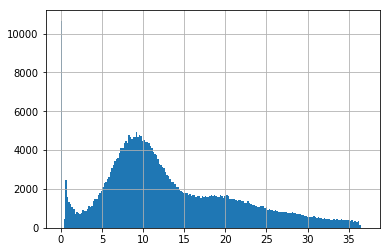

In [112]:
meth_df.methylation.hist(bins=np.linspace(0, 37, 200))

In [ ]:
len(meth_df[meth_df["methylation"] <= 0]) / len(meth_df)

In [ ]:
# meth_df["methylation_trim"] = np.where(meth_df["methylation"]>=5,5,meth_df["methylation"])

In [107]:
# outliers removal
# Define the lower and upper percentile thresholds
lower_percentile = 0.05
upper_percentile = 0.95

# Calculate the lower and upper percentile values
lower_threshold = meth_df['methylation'].quantile(lower_percentile)
upper_threshold = meth_df['methylation'].quantile(upper_percentile)

meth_df.loc[(meth_df['methylation'] > upper_threshold), 'methylation'] = np.nan

In [108]:
meth_df.methylation.describe()

count    342647.000000
mean         13.235666
std           8.115441
min           0.000000
25%           7.696081
50%          11.211021
75%          18.382320
max          36.337134
Name: methylation, dtype: float64

# Histogram Matching

In [111]:
# Define the number of bins to use for the histogram
num_bins = 1000

# Compute the histogram of the modern methylation probability data
hist, bins = np.histogram(meth_df[np.isfinite(meth_df["modern_meth"])]["modern_meth"], bins=num_bins-1, density=True)

# Compute the cumulative distribution function (CDF) of the histogram
cdf = hist.cumsum()
cdf /= cdf[-1]

# Compute the histogram of the new methylation
new_hist, new_bins = np.histogram(meth_df[np.isfinite(meth_df["methylation"])]["methylation"], bins=np.linspace(0, 36.4, num_bins), density=True)

# Compute the CDF of the new measurements
new_cdf = new_hist.cumsum()
new_cdf /= new_cdf[-1]

# Use the inverse CDF of the methylation probability data to transform the new measurements
transformed_measurements = np.interp(new_cdf, cdf, bins[:-1])
print(transformed_measurements)
# Save the transformed measurements to a CSV file
# pd.DataFrame(transformed_measurements).to_csv('transformed_measurements.csv', index=False)

[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.00371886 0.00810319 0.00823487 0.00836256
 0.00849757 0.00862194 0.00876227 0.00885604 0.00894583 0.01307251
 0.01319637 0.01332999 0.01347336 0.01362941 0.01380594 0.01396881
 0.01814855 0.01832931 0.01848458 0.01867229 0.01881366 0.01901759
 0.02323785 0.02344705 0.0236682  0.02384602 0.02806769 0.02828621
 0.0285238  0.02882209 0.03309997 0.03343822 0.03374155 0.03809834
 0.0384449  0.03879926 0.04318461 0.04364808 0.04815018 0.04853796
 0.04893284 0.05341814 0.05389427 0.05850692 0.06310586 0.06351321
 0.06387934 0.06832657 0.06883608 0.0735588  0.07832756 0.07904604
 0.08367043 0.08832302 0.08894076 0.0981141

In [113]:
# Get the original values and corresponding indices
original_values = meth_df.loc[np.isfinite(meth_df["methylation"]), "methylation"]
original_indices = np.where(np.isfinite(meth_df["methylation"]))[0]

# Use digitize to find the bin indices for the original values
bin_indices = np.digitize(original_values, new_bins[:-1])
# for bin_idx in np.uniqueq(bin_indices):
#     print(bin_idx)
# print(len(bins))
print(len(bin_indices))
# Create a mapping dictionary with bin indices as keys and transformed values as values
mapping = {bin_idx: transformed_measurements[bin_idx - 1] for bin_idx in np.unique(bin_indices)}

# Update the "methylation" column with the transformed measurements
# for bin_idx in bin_indices:
#     print(bin_idx)
meth_df.loc[original_indices, "transformed_methylation"] = [mapping[bin_idx] for bin_idx in bin_indices]

342647


In [117]:
print(meth_df.methylation.describe())
fig = px.histogram(meth_df, x="methylation", nbins=200)
fig.show()

count    342647.000000
mean         13.235666
std           8.115441
min           0.000000
25%           7.696081
50%          11.211021
75%          18.382320
max          36.337134
Name: methylation, dtype: float64


In [115]:
print(meth_df.transformed_methylation.describe())
fig = px.histogram(meth_df, x="transformed_methylation", nbins=200)
fig.show()

count    342647.000000
mean          0.756991
std           0.283867
min           0.000000
25%           0.708972
50%           0.869867
75%           0.944087
max           0.998999
Name: transformed_methylation, dtype: float64


In [116]:
print(meth_df.modern_meth.describe())
fig = px.histogram(meth_df, x="modern_meth", nbins=200)
fig.show()

count    358557.000000
mean          0.757056
std           0.284310
min           0.000000
25%           0.705000
50%           0.870000
75%           0.945000
max           1.000000
Name: modern_meth, dtype: float64


# Comparing to the results of RoAM:

In [118]:
# read the results of RoAM:
roam_results = pd.read_csv("../../carmelab/backup/genomes/meth_maps/Altai_chr21.csv")
roam_results["chrom"] = roam_results["chrom"] + 1
roam_results["start"] = roam_results["start"] - 1
roam_results["end"] = roam_results["end"] - 1

roam_results.head(20)

,no_c,no_t,chrom,start,end,meth
0,127.0,1.0,21,9411551,9411552,0.656566
1,112.0,1.0,21,9411783,9411784,0.606061
2,NaN,NaN,21,9412098,9412099,0.565657
3,NaN,NaN,21,9412375,9412376,0.535354
4,36.0,0.0,21,9412502,9412503,0.535354
5,NaN,NaN,21,9412807,9412808,0.505051
6,NaN,NaN,21,9413582,9413583,0.616162
7,144.0,1.0,21,9413762,9413763,0.707071
8,NaN,NaN,21,9414794,9414795,0.707071
9,NaN,NaN,21,9414803,9414804,0.707071


## Compare Count Results

In [ ]:
meth_df.head()

In [ ]:
count_comp = df_cnt.join(roam_results[["start", "no_c", "no_t"]].set_index("start"), how="left")
print(count_comp.corr())
g = sns.pairplot(count_comp)
plt.show()
print("\nSpearman correlation:")
print(count_comp.corr(method="spearman"))

In [ ]:
fig = px.scatter(count_comp, x="t", y="no_t", hover_data={"position": count_comp.index, "c_my":count_comp.c, "c_roam":count_comp.no_c})
fig.show()

In [ ]:
count_comp.head()

In [ ]:
print(count_comp.t.describe())
print()
print(count_comp.no_t.describe())

In [ ]:
def count_coverage(position):
    altai_chr21_samfile = load_samfile("altai")
    tuples = altai_chr21_samfile.count_coverage('21', position, position+1, quality_threshold=20) # quality isn't read quality
    data_dict = {'A': [tuples[0][0]], 'C': [tuples[1][0]], 'G': [tuples[2][0]], 'T': [tuples[3][0]]}
    altai_chr21_samfile.close()
    return pd.DataFrame(data_dict, index=[position])

In [ ]:
%%time
# count amount of reads covering certain position / iterating over all positions in CpG dict
cpg_coords = list(chr21_cpgs_dict.keys())
print("number of cpgs:", len(cpg_coords))


# Create a DataFrame from the dictionary with pos as the index
with Pool() as p:
        counts = p.map(count_coverage, [int(coord)-1 for coord in cpg_coords])
        
count_table_by_pos = pd.concat(counts)

In [ ]:
count_table_by_pos.head()

In [ ]:
print(count_coverage(11129267))
print(count_coverage(11129268))
print(count_coverage(11129269))

In [ ]:
samfile = load_samfile("altai")
df_ls = []
good_reads = 0
for read in samfile.fetch("21", 11129267, 11129270):
#     print(read.query_sequence)
#     print(read.is_reverse)
#     print(read.get_aligned_pairs())
#     print(read.get_forward_qualities())
#     print(read.mapping_quality)

    if read.mapping_quality > 18 and read.query_length == read.reference_length and not read.is_duplicate and not read.is_unmapped:# and read.is_forward:
                good_reads += 1
                read_aligned_pares = read.get_aligned_pairs()
                read_sequence = read.query_sequence
                ref_sequence = read.get_reference_sequence()
                for index, base in enumerate(read_sequence):
                    if read.is_forward:
                        if read_aligned_pares[index][1] and (str(read_aligned_pares[index][1]+1) in chr21_cpgs_dict) and index == read_aligned_pares[index][0] and read.query_alignment_qualities[index] > 20:
                            position_in_reference = read_aligned_pares[index][1]
                            new_row = pd.DataFrame([{
                                "read_name":read.query_name,
                                "position_in_reference": position_in_reference,
                                "position_in_read": read_aligned_pares[index][0],
                                "after": base,
                                "before": ref_sequence[index],
                                "distance_from_end": read.query_length - (read_aligned_pares[index][0] + 1),
                                "read_length": read.query_length,
        #                             "distance_from_cpg_island": get_distance_from_cpg(chromosome, position_in_reference),
#                                     "letter_before_read": letter_before_read,
#                                     "letter_after_read": letter_after_read,
#                                     "letter_before_ref": letter_before_ref,
#                                     "letter_after_ref": letter_after_ref,
#                                     "is_cpg_coord": str(position_in_reference+1) in chr21_cpgs_dict,
                                "is_reverse": read.is_reverse,
#                                     "chromosome": 21,
    #                             "modern_methylation": chr21_cpgs_dict[str(read_aligned_pares[index][1]+1)]
                            }])
                            df_ls.append(new_row)
                            
                    else:
                        if read_aligned_pares[index][1] and (str(read_aligned_pares[index][1]) in chr21_cpgs_dict) and index == read_aligned_pares[index][0] and read.query_alignment_qualities[index] > 20:
                            position_in_reference = read_aligned_pares[index][1] - 1
                            new_row = pd.DataFrame([{
                                "read_name":read.query_name,
                                "position_in_reference": position_in_reference,
                                "position_in_read": read_aligned_pares[index][0],
                                "after": "T" if base.lower() == "a" else "C",
                                "before": ref_sequence[index],
                                "distance_from_end": read.query_length - (read_aligned_pares[index][0] + 1),
                                "read_length": read.query_length,
        #                             "distance_from_cpg_island": get_distance_from_cpg(chromosome, position_in_reference),
#                                     "letter_before_read": letter_before_read,
#                                     "letter_after_read": letter_after_read,
#                                     "letter_before_ref": letter_before_ref,
#                                     "letter_after_ref": letter_after_ref,
#                                     "is_cpg_coord": str(position_in_reference+1) in chr21_cpgs_dict,
                                "is_reverse": read.is_reverse,
#                                     "chromosome": 21,
    #                             "modern_methylation": chr21_cpgs_dict[str(read_aligned_pares[index][1]+1)]
                            }])
                            df_ls.append(new_row)
samfile.close()
print("good reads:", good_reads)
test_df = pd.concat(df_ls, axis=0, ignore_index=True)

In [ ]:
test_df.groupby(["position_in_reference", "is_reverse", "after", "before"]).count()

In [ ]:
cnt_roam = df_cnt.join(roam_results[["start", "no_c", "no_t"]].set_index("start"), how="left")
cnt_roam["c_minus_roam"] = cnt_roam["c"] - cnt_roam["no_c"]
cnt_roam["t_minus_roam"] = cnt_roam["t"] - cnt_roam["no_t"]
cnt_roam.head()

## Compare Methylation

In [119]:
roam_cmp = meth_df.set_index("position").join(roam_results[["start", "meth"]].set_index("start"), how="left")
roam_cmp.head()

,methylation,modern_meth,transformed_methylation,meth
position,,,,
9412502,NaN,0.000,NaN,0.535354
9413582,NaN,0.000,NaN,0.616162
9416217,NaN,0.165,NaN,0.646465
9416821,NaN,0.075,NaN,0.595960
9418169,NaN,0.635,NaN,0.525253


In [120]:
roam_cmp = roam_cmp.rename(columns={'meth': 'roam_meth'})

In [121]:
roam_cmp.head()

,methylation,modern_meth,transformed_methylation,roam_meth
position,,,,
9412502,NaN,0.000,NaN,0.535354
9413582,NaN,0.000,NaN,0.616162
9416217,NaN,0.165,NaN,0.646465
9416821,NaN,0.075,NaN,0.595960
9418169,NaN,0.635,NaN,0.525253


In [122]:
roam_cmp['methylation'].isna().sum()

18035

Pearson Correlation:
                         methylation  modern_meth  transformed_methylation  \
methylation                 1.000000     0.272868                 0.764123   
modern_meth                 0.272868     1.000000                 0.483949   
transformed_methylation     0.764123     0.483949                 1.000000   
roam_meth                   0.488586     0.592638                 0.785784   

                         roam_meth  
methylation               0.488586  
modern_meth               0.592638  
transformed_methylation   0.785784  
roam_meth                 1.000000  

Spearman Correlation:
                         methylation  modern_meth  transformed_methylation  \
methylation                 1.000000     0.193693                 0.999938   
modern_meth                 0.193693     1.000000                 0.193496   
transformed_methylation     0.999938     0.193496                 1.000000   
roam_meth                   0.560086     0.255582                 0.

/usr/lib/python3/dist-packages/numpy/lib/histograms.py:824: RuntimeWarning:

invalid value encountered in greater_equal

/usr/lib/python3/dist-packages/numpy/lib/histograms.py:825: RuntimeWarning:

invalid value encountered in less_equal



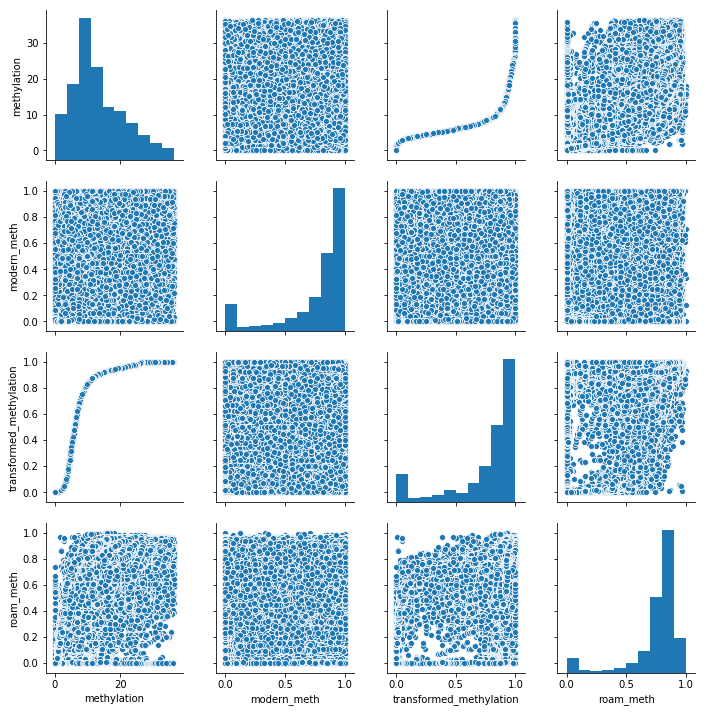

In [123]:
print("Pearson Correlation:")
print(roam_cmp.corr(method="pearson"))
print("\nSpearman Correlation:")
print(roam_cmp.corr(method="spearman"))
g = sns.pairplot(roam_cmp)
plt.show()

In [124]:
new_cmp = roam_cmp.dropna()
print("methylation and modern methylation")
res = pearsonr(new_cmp['methylation'], new_cmp['modern_meth'])
print(res)
print(np.corrcoef(new_cmp['methylation'], new_cmp['modern_meth']))

print("\nmethylation and roam methylation")
res = pearsonr(new_cmp['methylation'], new_cmp['roam_meth'])
print(res)
print(np.corrcoef(new_cmp['methylation'], new_cmp['roam_meth']))

print("\ntransformed and modern methylation")
res = pearsonr(new_cmp['transformed_methylation'], new_cmp['modern_meth'])
print(res)
print(np.corrcoef(new_cmp['transformed_methylation'], new_cmp['modern_meth']))
res = spearmanr(new_cmp['transformed_methylation'], new_cmp['modern_meth'])
print(res)

print("\ntransformed and roam methylation ")
res = pearsonr(new_cmp['transformed_methylation'], new_cmp['roam_meth'])
print(res)
print(np.corrcoef(new_cmp['transformed_methylation'], new_cmp['roam_meth']))

print("\nroam and modern methylation ")
res = pearsonr(new_cmp['roam_meth'], new_cmp['modern_meth'])
print(res)
print(np.corrcoef(new_cmp['roam_meth'], new_cmp['modern_meth']))


methylation and modern methylation
(0.2730675668393761, 0.0)
[[1.         0.27306757]
 [0.27306757 1.        ]]

methylation and roam methylation
(0.48917977718777855, 0.0)
[[1.         0.48917978]
 [0.48917978 1.        ]]

transformed and modern methylation
(0.4842351916084468, 0.0)
[[1.         0.48423519]
 [0.48423519 1.        ]]
SpearmanrResult(correlation=0.19367658448392458, pvalue=0.0)

transformed and roam methylation 
(0.7864648762392791, 0.0)
[[1.         0.78646488]
 [0.78646488 1.        ]]

roam and modern methylation 
(0.604882310577623, 0.0)
[[1.         0.60488231]
 [0.60488231 1.        ]]


In [ ]:
pearsonr([1, 2, 3], [-1,-2,-3.8])

# Comparing to t/c ratio

In [ ]:
ct_comp = meth_df.set_index("position").join(df_cnt, how="left")
ct_comp["t_ratio"] = np.where(ct_comp["t"] > 0, ct_comp["t"] / ct_comp["c"], 0)
ct_comp.head()

In [ ]:
print("Pearson Correlation:")
t_rat_cmp = ct_comp[["methylation", "t_ratio"]]
print(t_rat_cmp.corr())
g = sns.pairplot(t_rat_cmp)
plt.show()

print("\n\nSpearman Correlation:")
print(t_rat_cmp.corr(method="spearman"))


In [ ]:
t_rat_cmp.sort_values(by="t_ratio", ascending=False)

# Comparing to Modern Methylation:

In [110]:
meth_df["modern_meth"] = meth_df["position"].apply(lambda x: chr21_cpgs_dict[str(x + 1)])
meth_df.head()

,methylation,position,modern_meth
0,NaN,9412502,0.000
1,NaN,9413582,0.000
2,NaN,9416217,0.165
3,NaN,9416821,0.075
4,NaN,9418169,0.635


In [ ]:
print("Pearson Correlation:")
print(meth_df[["methylation", "modern_meth"]].corr())
g = sns.pairplot(meth_df[["methylation", "modern_meth"]])
plt.show()

print("\n\nSpearman Correlation:")
print(meth_df[["methylation", "modern_meth"]].corr(method="spearman"))


In [ ]:
no_zero = meth_df[meth_df["methylation"] > 0]
no_zero.corr()

# Comparing RoAM to Modern Methylation

In [ ]:
roam_results["modern_meth"] = roam_results["start"].apply(lambda x: chr21_cpgs_dict[str(x+1)])
roam_results.head()

In [ ]:
print("pearson correlation:")
print(roam_results[["meth", "modern_meth"]].corr())

print("\n\nspearman correlation:")
print(roam_results[["meth", "modern_meth"]].corr(method="spearman"))

# Finding smoothing size

In [ ]:
count_table_smooth = []

In [125]:
def analyze_window_size(cnt_table, win_size):
    default_count_table = smooth_count_table(cnt_table, win_size)
    meth_df = get_methylation(default_count_table, 5000)
    i1 = meth_df.set_index("position").index
    meth_df_no_outliers = meth_df[i1.isin(df_cnt.index)]
    # compare with roam
    roam_cmp = meth_df_no_outliers.set_index("position").join(roam_results[["start", "meth"]].set_index("start"), how="left")
    pears_corr_roam = roam_cmp.corr(method="pearson").iloc[0, 1]
    print(pears_corr_roam)
    spear_corr_roam = roam_cmp.corr(method="spearman").iloc[0, 1]
    print(spear_corr_roam)
    # compare with modern meth
    meth_df_no_outliers["modern_meth"] = meth_df_no_outliers["position"].apply(lambda x: chr21_cpgs_dict[str(x + 1)])
    pears_corr_modern = meth_df_no_outliers[["methylation", "modern_meth"]].corr().iloc[0, 1]
    print(pears_corr_modern)
    spear_corr_modern = meth_df_no_outliers[["methylation", "modern_meth"]].corr(method="spearman").iloc[0, 1]
    print(spear_corr_modern)
    return pd.DataFrame({"window_size": [win_size],
                         "pears_corr_roam": [pears_corr_roam],
                         "spear_corr_roam": [spear_corr_roam],
                         "pears_corr_modern": [pears_corr_modern],
                         "spear_corr_modern": [spear_corr_modern]})


In [133]:
%%time
results = []
for win_size in range(3, 33, 2):
    print(win_size)
    for i in range(3):
        results.append(analyze_window_size(filtered_count_table, win_size))
    
windows_df = pd.concat(results, axis=0, ignore_index=True)

3
finished1
finished2 5000
finished3
finished4
0.39079878422375264
0.5432676420801259
0.1890032865486524
0.16936190689061206
finished1
finished2 5000
finished3
finished4
0.39864040319578725
0.5486936655116461
0.2094326599086798
0.19659646531217298
finished1
finished2 5000
finished3
finished4
0.4073537677843186
0.5433763839788764
0.17607476934431013
0.15344086363337267
5
finished1
finished2 5000
finished3
finished4
0.3746877625737978
0.5321104431760205
0.17545040657161942
0.16868555386485823
finished1
finished2 5000
finished3
finished4
0.40991862236924653
0.5515571996061437
0.21416548051008413
0.18698138700047737
finished1
finished2 5000
finished3
finished4
0.3855088277664479
0.5481361159573181
0.19716769922557612
0.18017216879926926
7
finished1
finished2 5000
finished3
finished4
0.4107330419446758
0.5528895806807348
0.20174685978488596
0.18603839636304756
finished1
finished2 5000
finished3
finished4
0.4081165456327235
0.5525100364440064
0.20481565313457684
0.1912343540897131
finished1


In [134]:
windows_df.groupby("window_size").mean()

,pears_corr_roam,spear_corr_roam,pears_corr_modern,spear_corr_modern
window_size,,,,
3,0.398931,0.545113,0.191504,0.173133
5,0.390038,0.543935,0.195595,0.178613
7,0.411751,0.554413,0.194854,0.177066
9,0.389405,0.544395,0.199059,0.181964
11,0.402667,0.538181,0.202780,0.180176
13,0.388234,0.536826,0.197158,0.180781
15,0.407120,0.538656,0.197765,0.169191
17,0.409645,0.548080,0.217442,0.181164
19,0.413684,0.554900,0.209162,0.180733


# Quality Verification 

In [ ]:
roam_cmp.head()

In [ ]:
def get_distance_from_cpg(position, chromosome="21"):
#     print(position)
    distance_from_cpg = math.inf
    cpg_in_chrom = cpg_df[cpg_df['seqnames'] == chromosome]
    #finding nearest CpG island, that starts before position in genome (because after is too late)
    nearest_earlier_island_start_index = np.searchsorted(cpg_in_chrom.start, position , side="ledt")[0] - 1
#     print(nearest_earlier_island_start_index)
    if(nearest_earlier_island_start_index == -1): # smaller than th esmallest island start site
        return cpg_in_chrom.iloc[0].start - int(position)
    else:
        nearest_earlier_island = cpg_in_chrom.iloc[nearest_earlier_island_start_index]
    # if it's end is after the position given, then it's within the island
    if position <= nearest_earlier_island.end:
        distance_from_cpg = 0
    else:
        distance_from_earlier = position - nearest_earlier_island.end
        distance_from_later = math.inf
        if (nearest_earlier_island_start_index + 1) < len(cpg_in_chrom):
            nearest_later_island = cpg_in_chrom.iloc[nearest_earlier_island_start_index + 1]
            distance_from_later = nearest_later_island.start - position
        distance_from_cpg = min(distance_from_earlier, distance_from_later)
                              
    return distance_from_cpg


In [ ]:
%%time
with Pool(32) as pool:
    mapped_values = list(tqdm.tqdm(pool.imap(get_distance_from_cpg, roam_cmp.index), total=len(roam_cmp.index)))

In [ ]:
mapped_values[:5]

In [ ]:
roam_cmp["distance_from_cpg_island"] = mapped_values
roam_cmp.head()

In [ ]:
fig = go.Figure()

cols = ['roam_meth','transformed_methylation', 'modern_meth']
for col in cols:
    fig.add_trace(go.Box(y=roam_cmp[col], x=roam_cmp["distance_from_cpg_island"] == 0, name=col, boxmean=True))

fig.update_layout(
    title = "Methylation Levels in CpG Islands",
    yaxis_title = 'Methylation Probabilty',
    xaxis_title='CpG Island',
    boxmode='group' # group together boxes of the different traces for each value of x
)
fig.show()

In [ ]:
fig = go.Figure()
fig.add_trace(go.Box(y=roam_cmp["methylation"], x=roam_cmp["distance_from_cpg_island"] == 0, name=col, boxmean=True))
fig.update_layout(
    title = "Methylation Levels in CpG Islands",
    yaxis_title = 'Methylation Probabilty',
    xaxis_title='CpG Island',
    boxmode='group' # group together boxes of the different traces for each value of x
)
fig.show()